### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
gov_arch_csv = '../data/v2/communities_data_prepped.csv'

In [7]:
gov_df = pd.read_csv(gov_arch_csv)

In [8]:
gov_df.head()

,Name,Institutions,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mecha

# Normalized Correlation Matrix

In [9]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [10]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [11]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

## Sort all correlations 

In [12]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [13]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [14]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

enforcement_mechanisms_include_seizing_of_property  decision_making_mechanisms_include_plurality_voting         1.000000
decision_making_mechanisms_include_lobbying         Geography: Africa West, Mid-western Nigeria                 1.000000
Geography: Oceania                                  Region: Oceania                                             1.000000
decision_making_mechanisms_include_quorum           access_mechanisms_include_screening_process                 1.000000
decision_making_mechanisms_include_secret_ballot    decision_making_mechanisms_include_vote_by_show_of_hands    1.000000
                                                                                                                  ...   
Time span: End                                      decision_making_mechanisms_include_assembly_central        -0.391089
Time span: Start                                    decision_making_mechanisms_include_magistrate_official     -0.442706
                                

In [15]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/mechanisms_all_correlations.csv')

In [16]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                    Time span: Duration                                      -0.628655
                                                    decision_making_mechanisms_include_assembly_central      -0.525026
                                                    decision_making_mechanisms_include_council_central_      -0.459154
                                                    decision_making_mechanisms_include_magistrate_official   -0.442706
Time span: End                                      decision_making_mechanisms_include_assembly_central      -0.391089
                                                                                                                ...   
decision_making_mechanisms_include_power_fluidity   Geography: South America, Brazil                          1.000000
decision_making_mechanisms_include_mandate          Geography: Middle East, Mesopotamia, Babylonia            1.000000
decision_making_mechanisms_include_power_fluidit

In [17]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/mechanisms_negative_correlations.csv')

# Mechanisms

In [18]:
mechanisms_list = [x for x in gov_df.columns if 'mechanisms_' in x]
mechanisms_list.sort()
mechanisms_list

['access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_election',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_induction_rite_ceremony',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_matrilineality',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_sc

In [19]:
access_mechanisms = [x for x in gov_df.columns if 'access_mechanisms_' in x]

In [20]:
decision_making_mechanisms = [x for x in gov_df.columns if 'decision_making_mechanisms_' in x]

In [21]:
enforcement_mechanisms = [x for x in gov_df.columns if 'enforcement_mechanisms_' in x]

In [22]:
# mechanisms_df = gov_df[['Name'] + mechanisms_list]
mechanisms_df = gov_df[mechanisms_list]

In [23]:
mechanisms_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_exit,enfor

In [24]:
mechanisms_df.dropna(how='any').corr()

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_exit,enfor

In [25]:
plt.figure(figsize=(40,40))
sns.heatmap(mechanisms_df.corr(),
            cmap='BrBG')

<Axes: >

### Look at correlations for specific variables

In [26]:
norm_corr['Time span: Duration'].sort_values(ascending=False)

Time span: Duration                                                                1.000000
decision_making_mechanisms_include_assembly_central                                0.593998
decision_making_mechanisms_include_council_central_                                0.540029
decision_making_mechanisms_include_magistrate_official                             0.494048
Region: Europe                                                                     0.468898
access_mechanisms_include_election                                                 0.413483
Geography: Europe South, Greece                                                    0.364254
decision_making_mechanisms_include_board_committee                                 0.349572
Size: 100,001 - 1,000,000                                                          0.340529
decision_making_mechanisms_include_ratification_acclamation_only                   0.323940
decision_making_mechanisms_include_delegation                                   

In [27]:
norm_corr['Time span: Duration'].sort_values(ascending=True)

Time span: Start                                                                  -0.628655
Time span: End                                                                    -0.351103
decision_making_mechanisms_include_council_local                                  -0.256984
Region: North America                                                             -0.250901
Geography: Asia Southeast                                                         -0.205198
access_mechanisms_include_matrilineality                                          -0.203845
access_mechanisms_include_dreaming                                                -0.188809
Geography: North America                                                          -0.186387
access_mechanisms_include_female_participation                                    -0.167975
enforcement_mechanisms_include_destruction_of_property                            -0.148262
enforcement_mechanisms_include_exit                                             

In [28]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.858498
access_mechanisms_include_blood_relations                                          0.572362
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.533083
enforcement_mechanisms_include_tribunal_court_                                     0.498555
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.348143
Size: 100,001 - 1,000,000                                                          0.324103
access_mechanisms_include_payment_for_occupying_office                             0.312830
enforcement_mechanisms_include_police                                              0.279761
access_mechanisms_include_election                                                 0.237331
decision_making_mechanisms_include_magistrate_official                          

In [29]:
norm_corr[['Region: Africa', 'Region: Oceania']]

,Region: Africa,Region: Oceania
Time span: Start,-0.093821,0.097482
Time span: End,-0.037543,0.069551
enforcement_mechanisms_include_seizing_of_property,-0.044535,-0.018643
decision_making_mechanisms_include_public_meetings,-0.104420,-0.043711
decision_making_mechanisms_include_power_fluidity,-0.036195,-0.015152
decision_making_mechanisms_include_petition,0.100247,-0.015152
decision_making_mechanisms_include_veto,-0.058222,-0.024372
decision_making_mechanisms_include_representation,0.089772,-0.064678
decision_making_mechanisms_include_rule_of_law,-0.047501,-0.019884
enforcement_mechanisms_include_appeal,-0.009020,-0.025422


In [30]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=True)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanism

In [31]:
norm_corr[['Time span: Duration'] + mechanisms_list].sort_values(by='Time span: Duration', ascending=False)

,Time span: Duration,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanism

In [32]:
norm_corr['Region: Africa'].sort_values(ascending=False)

Region: Africa                                                                     1.000000
Geography: Africa North                                                            0.858498
access_mechanisms_include_blood_relations                                          0.572362
enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription         0.533083
enforcement_mechanisms_include_tribunal_court_                                     0.498555
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.348143
Size: 100,001 - 1,000,000                                                          0.324103
access_mechanisms_include_payment_for_occupying_office                             0.312830
enforcement_mechanisms_include_police                                              0.279761
access_mechanisms_include_election                                                 0.237331
decision_making_mechanisms_include_magistrate_official                          

In [33]:
norm_corr['decision_making_mechanisms_include_assembly_central'].sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
decision_making_mechanisms_include_magistrate_official                             0.886780
access_mechanisms_include_election                                                 0.826600
decision_making_mechanisms_include_council_central_                                0.822872
Region: Europe                                                                     0.813049
Size: 100,001 - 1,000,000                                                          0.707961
decision_making_mechanisms_include_ratification_acclamation_only                   0.677919
Geography: Europe North                                                            0.633486
decision_making_mechanisms_include_balance_of_power                                0.625751
Time span: Duration                                                                0.593998
decision_making_mechanisms_include_temporary_position_of_power_term_limits      

In [34]:
mechanisms_corr_df = norm_corr[mechanisms_list]

In [35]:
mechanisms_corr_df

,access_mechanisms_include_age_boundaries,access_mechanisms_include_blood_relations,access_mechanisms_include_co-optation,access_mechanisms_include_divine_right,access_mechanisms_include_dreaming,access_mechanisms_include_election,access_mechanisms_include_enfranchisement,access_mechanisms_include_female_participation,access_mechanisms_include_gerontocracy,access_mechanisms_include_heredity,access_mechanisms_include_induction_rite_ceremony,access_mechanisms_include_life_appointment,access_mechanisms_include_lottery_random_selection,access_mechanisms_include_matriarchy,access_mechanisms_include_matrilineality,access_mechanisms_include_meritocracy,access_mechanisms_include_open_political_unit,access_mechanisms_include_patronage_for_office,access_mechanisms_include_payment_for_occupying_office,access_mechanisms_include_popularity_,access_mechanisms_include_property_requirement,access_mechanisms_include_screening_process,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_balance_of_power,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_confederacy,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_gathering,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_lobbying,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_mandate,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_plurality_voting,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_president_consul_chief_executive,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_word_of_mouth,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_capital_punishment,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_exit,enfor

In [36]:
query_mechanisms_df = mechanisms_corr_df.transpose()

In [37]:
query_mechanisms_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

## Time x Mechanism

In [38]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [39]:
time_mechanisms = query_mechanisms_df[time_span_cols]
time_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_age_boundaries,-0.269725,-0.246350,0.193201
access_mechanisms_include_blood_relations,-0.204917,-0.135885,0.273128
access_mechanisms_include_co-optation,0.153112,0.136422,-0.118100
access_mechanisms_include_divine_right,-0.145515,-0.194135,-0.046659
access_mechanisms_include_dreaming,0.167883,0.125514,-0.188809
access_mechanisms_include_election,-0.307968,-0.203003,0.413483
access_mechanisms_include_enfranchisement,-0.264632,-0.215850,0.253250
access_mechanisms_include_female_participation,0.194746,0.166311,-0.167975
access_mechanisms_include_gerontocracy,-0.185142,-0.206750,0.039829
access_mechanisms_include_heredity,-0.063205,-0.075109,0.002442


In [40]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/time_mechanisms.png')
plt.show()

### Time x Mechanism: Access, Decision Making, Enforcement

In [41]:
time_access_mechanisms = time_mechanisms.loc[access_mechanisms]

In [42]:
time_access_mechanisms

,Time span: Start,Time span: End,Time span: Duration
access_mechanisms_include_matrilineality,0.223798,0.186734,-0.203845
access_mechanisms_include_patronage_for_office,0.025273,0.021299,-0.022498
access_mechanisms_include_age_boundaries,-0.269725,-0.246350,0.193201
access_mechanisms_include_blood_relations,-0.204917,-0.135885,0.273128
access_mechanisms_include_life_appointment,0.115424,0.116195,-0.056128
access_mechanisms_include_heredity,-0.063205,-0.075109,0.002442
access_mechanisms_include_popularity_,0.142229,0.139275,-0.078780
access_mechanisms_include_divine_right,-0.145515,-0.194135,-0.046659
access_mechanisms_include_co-optation,0.153112,0.136422,-0.118100
access_mechanisms_include_female_participation,0.194746,0.166311,-0.167975


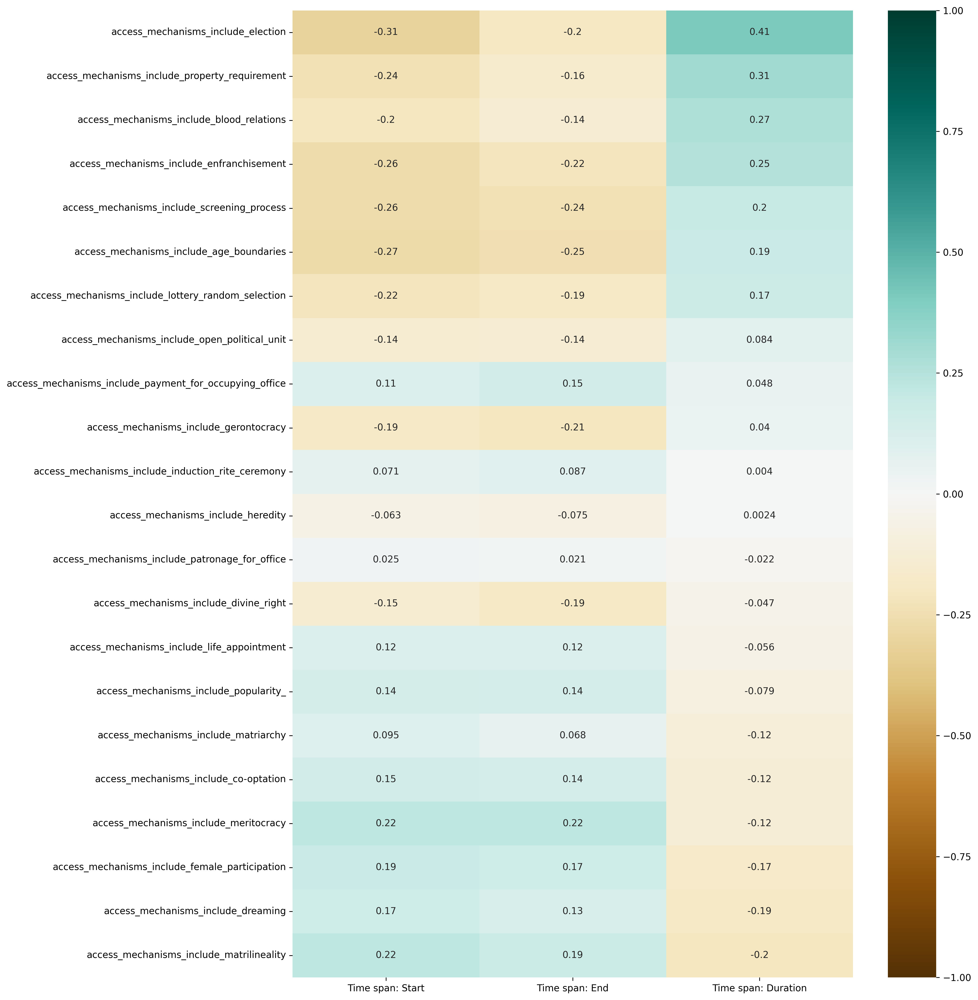

In [43]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/time_access_mechanisms.png')
plt.show()

In [44]:
time_decision_making_mechanisms = time_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/time_decision_making_mechanisms.png')
plt.show()

In [ ]:
time_enforcement_mechanisms = time_mechanisms.loc[enforcement_mechanisms]

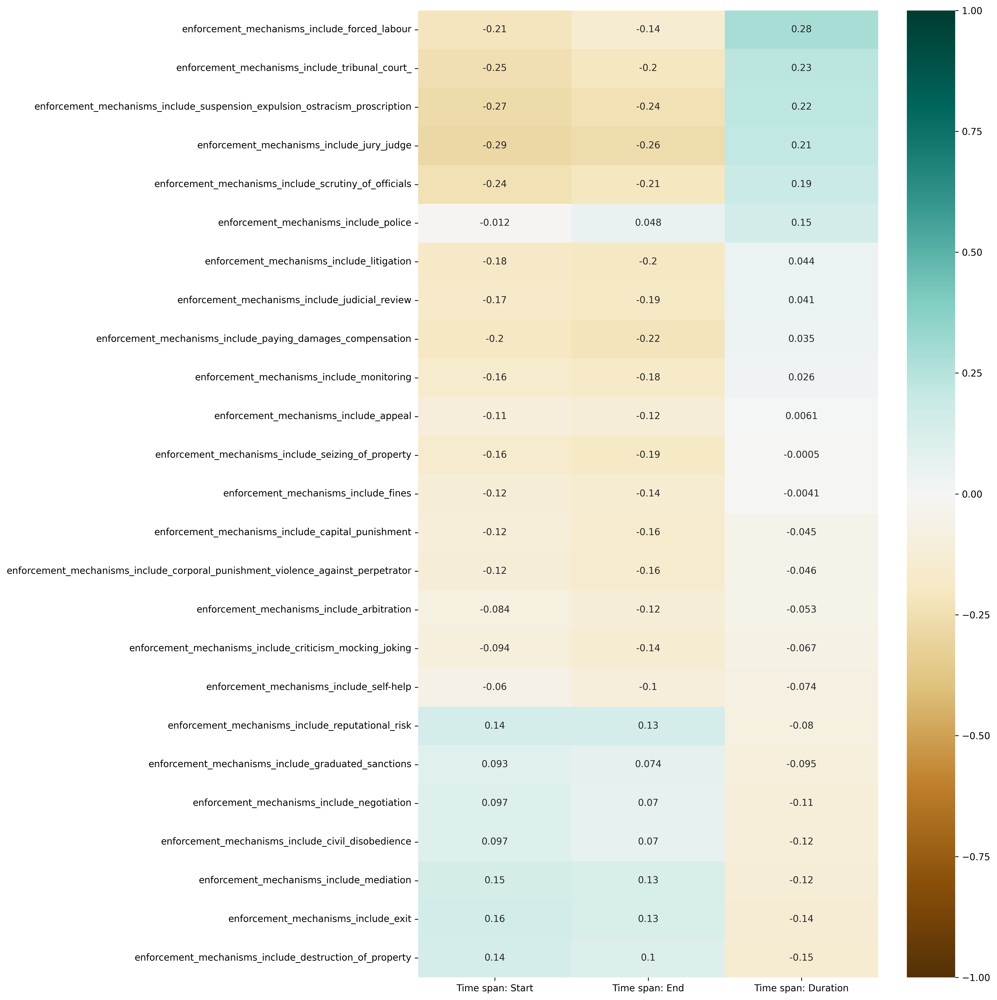

In [47]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_mechanisms.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/time_enforcement_mechanisms.png')
plt.show()

# Region x Mechanism

In [48]:
region_cols = [r for r in list(gov_df) if 'Region: ' in r] 

In [49]:
region_cols

['Region: Africa',
 'Region: Europe',
 'Region: Asia',
 'Region: Middle East',
 'Region: North America',
 'Region: Central America',
 'Region: South America',
 'Region: Oceania']

In [50]:
region_mechanisms = query_mechanisms_df[region_cols]
region_mechanisms

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_mechanisms_include_age_boundaries,-0.014975,0.340959,-0.104558,-0.059302,-0.077139,-0.052370,-0.025844,-0.025844
access_mechanisms_include_blood_relations,0.572362,-0.034642,0.120284,-0.105506,0.028978,0.019191,0.087497,-0.045979
access_mechanisms_include_co-optation,-0.063344,0.070407,-0.107278,-0.060845,-0.079145,-0.053732,-0.026516,-0.026516
access_mechanisms_include_divine_right,0.001361,-0.109403,-0.106846,0.108554,0.157287,-0.053516,-0.026409,-0.026409
access_mechanisms_include_dreaming,-0.063612,-0.110310,0.128873,-0.061102,0.142546,-0.053959,-0.026628,-0.026628
access_mechanisms_include_election,0.237331,0.766966,-0.138091,-0.134695,-0.083051,-0.089675,-0.058700,-0.058700
access_mechanisms_include_enfranchisement,-0.051567,0.331426,-0.087332,-0.049533,-0.064430,-0.043742,-0.021586,-0.021586
access_mechanisms_include_female_participation,0.127942,-0.191161,-0.118504,-0.153921,0.306753,-0.135927,-0.067079,0.186472
access_mechanisms_include_gerontocracy,-0.064171,0.022832,0.014923,-0.066788,0.188506,-0.130201,-0.064253,-0.064253
access_mechanisms_include_heredity,-0.032924,-0.085534,0.153458,-0.054057,0.144409,0.104069,-0.076688,-0.076688


In [51]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_mechanisms = region_mechanisms[cols_to_move + [col for col in region_mechanisms.columns if col not in cols_to_move]]

In [52]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/region_mechanisms.png')
plt.show()

### Region x Mechanism: Access, Decision Making, Enforcement

In [ ]:
region_access_mechanisms = region_mechanisms.loc[access_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/region_access_mechanisms.png')
plt.show()

In [55]:
region_decision_making_mechanisms = region_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/region_decision_making_mechanisms.png')
plt.show()

In [ ]:
region_enforcement_mechanisms = region_mechanisms.loc[enforcement_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_mechanisms.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/region_enforcement_mechanisms.png')
plt.show()

# Size x Mechanism

In [49]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [50]:
size_mechanisms = query_mechanisms_df[size_cols]

In [53]:
norm_corr[size_cols].head()

,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,0.093110,-0.008791,-0.015630,-0.285960,-0.111131,-0.060900,-0.043561
Time span: End,0.073655,-0.056758,0.036084,-0.206111,-0.019847,-0.037787,0.000965
enforcement_mechanisms_include_seizing_of_property,-0.018643,-0.056625,-0.063998,0.318257,-0.040075,-0.034821,-0.038960
decision_making_mechanisms_include_public_meetings,0.110244,-0.098177,0.190932,0.144818,-0.056627,0.279748,-0.091347
decision_making_mechanisms_include_power_fluidity,-0.015152,0.165278,-0.085481,-0.032960,-0.032570,-0.028300,-0.031664


In [54]:
norm_corr[size_cols].to_csv('../csv/v2/size_correlations.csv')

In [ ]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/size_mechanisms.png')
plt.show()

### Size x Mechanism: Access, Decision Making, Enforcement

In [ ]:
size_access_mechanisms = size_mechanisms.loc[access_mechanisms]

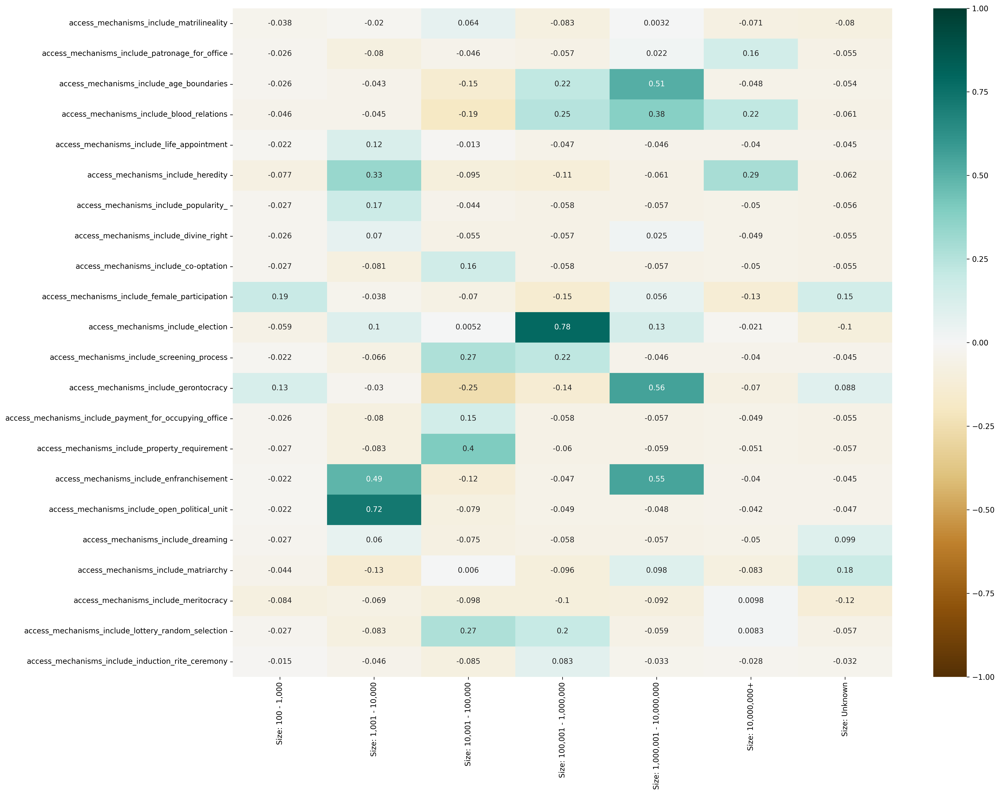

In [63]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/size_access_mechanisms.png')
plt.show()

In [64]:
size_decision_making_mechanisms = size_mechanisms.loc[decision_making_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/size_decision_making_mechanisms.png')
plt.show()

In [ ]:
size_enforcement_mechanisms = size_mechanisms.loc[enforcement_mechanisms]

In [ ]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_mechanisms,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/size_enforcement_mechanisms.png')
plt.show()

# Query and sort for mechanisms

In [ ]:
def query_mech(col_name, ascending=False):
    # Return a sorted frame for a single column
    return query_mechanisms_df[col_name].sort_values(ascending=ascending)

In [69]:
query_mechanisms_df['Time span: Start'].sort_values(ascending=False)

decision_making_mechanisms_include_council_local                                   0.269797
access_mechanisms_include_matrilineality                                           0.223798
access_mechanisms_include_meritocracy                                              0.222007
access_mechanisms_include_female_participation                                     0.194746
decision_making_mechanisms_include_confederacy                                     0.191628
decision_making_mechanisms_include_dual-sex_political_system                       0.180638
access_mechanisms_include_dreaming                                                 0.167883
enforcement_mechanisms_include_exit                                                0.155722
access_mechanisms_include_co-optation                                              0.153112
enforcement_mechanisms_include_mediation                                           0.148333
access_mechanisms_include_popularity_                                           

In [70]:
query_mech('Time span: Duration')

decision_making_mechanisms_include_assembly_central                                0.593998
decision_making_mechanisms_include_council_central_                                0.540029
decision_making_mechanisms_include_magistrate_official                             0.494048
access_mechanisms_include_election                                                 0.413483
decision_making_mechanisms_include_board_committee                                 0.349572
decision_making_mechanisms_include_ratification_acclamation_only                   0.323940
decision_making_mechanisms_include_delegation                                      0.318560
decision_making_mechanisms_include_temporary_position_of_power_term_limits         0.316241
access_mechanisms_include_property_requirement                                     0.312484
enforcement_mechanisms_include_forced_labour                                       0.283307
access_mechanisms_include_blood_relations                                       

In [71]:
query_mech('Time span: Duration', ascending=True)

decision_making_mechanisms_include_council_local                                  -0.256984
access_mechanisms_include_matrilineality                                          -0.203845
access_mechanisms_include_dreaming                                                -0.188809
access_mechanisms_include_female_participation                                    -0.167975
enforcement_mechanisms_include_destruction_of_property                            -0.148262
enforcement_mechanisms_include_exit                                               -0.139591
enforcement_mechanisms_include_mediation                                          -0.124303
decision_making_mechanisms_include_confederacy                                    -0.122042
access_mechanisms_include_meritocracy                                             -0.119308
decision_making_mechanisms_include_power_fluidity                                 -0.118961
access_mechanisms_include_co-optation                                           

In [74]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Correlations: Community Mechanisms', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/mechanisms_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_51670/2170790889.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [ ]:
plt.figure(figsize=(20,50))

heatmap = sns.heatmap(
    norm_corr[['Time span: Duration']].dropna().sort_values(
        by='Time span: Duration', 
        ascending=False), 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    annot_kws={"size": 8},
    xticklabels=1, 
    yticklabels=1, 
    cmap='BrBG')

heatmap.set_title('Features Correlating with Time span: Duration', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/duration_correlations.png')
plt.show()

# Time x Region x Size

In [76]:
norm_corr[time_span_cols + region_cols + size_cols]

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.948897,-0.628655,-0.093821,-0.351908,-0.053837,-0.325419,0.268980,0.145896,0.097687,0.097482,0.093110,-0.008791,-0.015630,-0.285960,-0.111131,-0.060900,-0.043561
Time span: End,0.948897,1.000000,-0.351103,-0.037543,-0.233421,-0.049425,-0.318687,0.222037,0.170556,0.069341,0.069551,0.073655,-0.056758,0.036084,-0.206111,-0.019847,-0.037787,0.000965
enforcement_mechanisms_include_seizing_of_property,-0.161654,-0.194837,-0.000504,-0.044535,0.249380,-0.075424,-0.042778,0.046944,-0.037777,-0.018643,-0.018643,-0.018643,-0.056625,-0.063998,0.318257,-0.040075,-0.034821,-0.038960
decision_making_mechanisms_include_public_meetings,-0.225945,-0.185419,0.213456,-0.104420,0.292104,0.088829,-0.100301,-0.021601,-0.033283,-0.043711,-0.043711,0.110244,-0.098177,0.190932,0.144818,-0.056627,0.279748,-0.091347
decision_making_mechanisms_include_power_fluidity,0.097687,0.069341,-0.118961,-0.036195,-0.062766,-0.061299,-0.034767,-0.045224,-0.030703,1.000000,-0.015152,-0.015152,0.165278,-0.085481,-0.032960,-0.032570,-0.028300,-0.031664
decision_making_mechanisms_include_petition,-0.193038,-0.170193,0.153340,0.100247,-0.062766,-0.061299,-0.034767,-0.045224,-0.030703,-0.015152,-0.015152,-0.015152,-0.046021,-0.085481,-0.032960,0.140745,-0.028300,-0.031664
decision_making_mechanisms_include_veto,-0.238660,-0.219285,0.167725,-0.058222,0.346629,-0.098603,-0.055925,0.015624,-0.049387,-0.024372,-0.024372,-0.024372,-0.074027,-0.102029,0.219831,0.491819,-0.045522,-0.050933
decision_making_mechanisms_include_representation,0.090264,0.132075,0.057654,0.089772,-0.217480,0.296655,-0.148413,0.015317,-0.131063,-0.064678,-0.064678,-0.064678,-0.067539,-0.132314,-0.140699,0.048673,0.067748,0.005402
decision_making_mechanisms_include_rule_of_law,-0.178580,-0.172533,0.104678,-0.047501,0.283978,-0.080447,-0.045627,-0.059350,-0.040293,-0.019884,-0.019884,-0.019884,-0.060396,-0.020017,0.300915,-0.042743,-0.037140,-0.041554
enforcement_mechanisms_include_appeal,-0.105820,-0.124945,0.006070,-0.009020,-0.000616,-0.102850,0.077379,-0.075878,-0.051514,-0.025422,-0.025422,-0.025422,-0.077215,0.113456,-0.055301,0.011036,-0.047483,-0.053126


In [77]:
time_region_size = norm_corr[time_span_cols + region_cols + size_cols].loc[time_span_cols + region_cols + size_cols]

In [78]:
time_region_size

,Time span: Start,Time span: End,Time span: Duration,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania,"Size: 100 - 1,000","Size: 1,001 - 10,000","Size: 10,001 - 100,000","Size: 100,001 - 1,000,000","Size: 1,000,001 - 10,000,000","Size: 10,000,000+",Size: Unknown
Time span: Start,1.000000,0.948897,-0.628655,-0.093821,-0.351908,-0.053837,-0.325419,0.268980,0.145896,0.097687,0.097482,0.093110,-0.008791,-0.015630,-0.285960,-0.111131,-0.060900,-0.043561
Time span: End,0.948897,1.000000,-0.351103,-0.037543,-0.233421,-0.049425,-0.318687,0.222037,0.170556,0.069341,0.069551,0.073655,-0.056758,0.036084,-0.206111,-0.019847,-0.037787,0.000965
Time span: Duration,-0.628655,-0.351103,1.000000,0.185851,0.468898,0.037938,0.180186,-0.250901,-0.012578,-0.118961,-0.117834,-0.094753,-0.113784,0.135294,0.340529,0.280816,0.087573,0.131622
Region: Africa,-0.093821,-0.037543,0.185851,1.000000,-0.149941,-0.146437,-0.083055,-0.108035,-0.073345,-0.036195,-0.036195,-0.036195,-0.041574,-0.066585,0.324103,0.016274,-0.067606,-0.075641
Region: Europe,-0.351908,-0.233421,0.468898,-0.149941,1.000000,-0.253937,-0.144026,-0.187344,-0.127189,-0.062766,-0.062766,-0.062766,0.100365,0.248352,0.595127,0.195397,-0.117236,-0.058820
Region: Asia,-0.053837,-0.049425,0.037938,-0.146437,-0.253937,1.000000,-0.140660,-0.182965,-0.124216,-0.061299,-0.061299,-0.061299,-0.186189,-0.210662,-0.133349,-0.083742,0.659500,0.052587
Region: Middle East,-0.325419,-0.318687,0.180186,-0.083055,-0.144026,-0.140660,1.000000,-0.103773,-0.070452,-0.034767,-0.034767,-0.034767,-0.105602,0.056493,-0.037911,-0.074736,-0.064939,0.432746
Region: North America,0.268980,0.222037,-0.250901,-0.108035,-0.187344,-0.182965,-0.103773,1.000000,-0.091642,-0.045224,-0.045224,0.313700,0.190456,-0.057572,-0.098379,-0.097214,-0.084470,-0.094509
Region: Central America,0.145896,0.170556,-0.012578,-0.073345,-0.127189,-0.124216,-0.070452,-0.091642,1.000000,-0.030703,-0.030703,-0.030703,-0.093256,-0.173219,0.161104,-0.065999,-0.057347,-0.064163
Region: South America,0.097687,0.069341,-0.118961,-0.036195,-0.062766,-0.061299,-0.034767,-0.045224,-0.030703,1.000000,-0.015152,-0.015152,0.165278,-0.085481,-0.032960,-0.032570,-0.028300,-0.031664


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_51670/658521247.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))


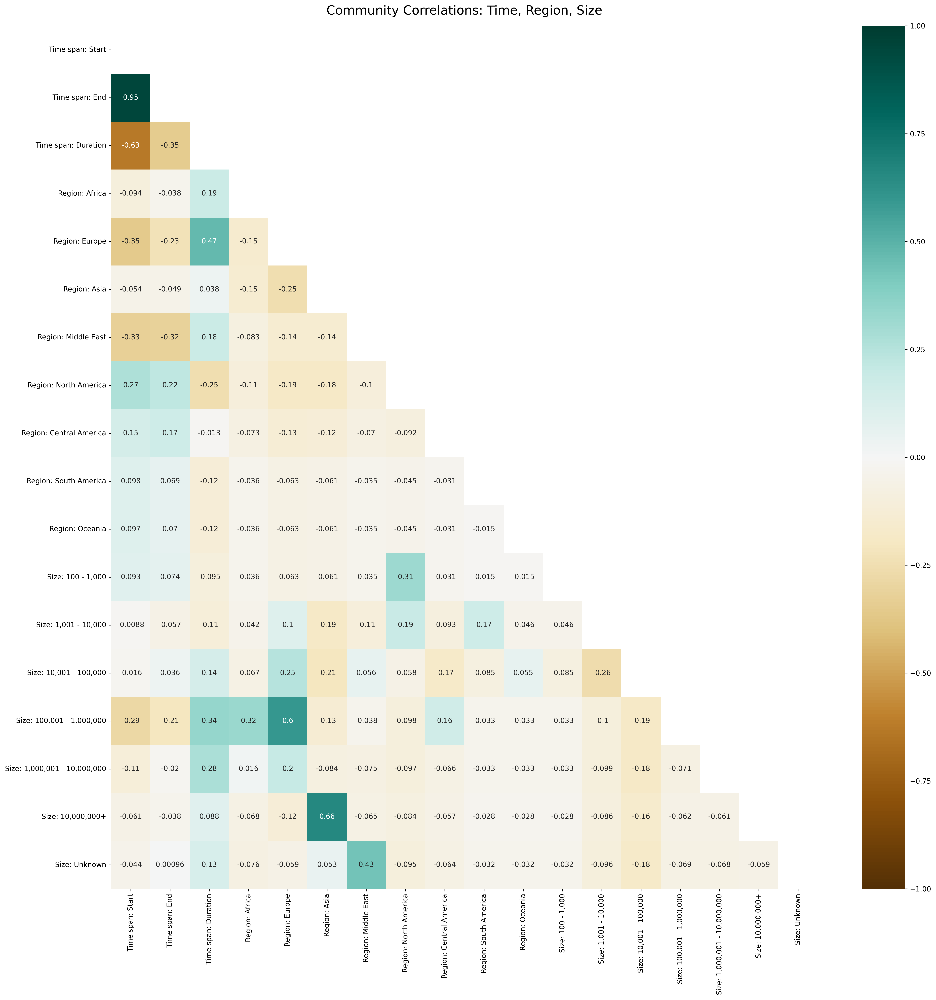

In [79]:
plt.figure(figsize=(20, 20))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(time_region_size, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    time_region_size, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=True, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Community Correlations: Time, Region, Size', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/communities_time_region_size.png')
plt.show()

## Time

In [80]:
time_corr = norm_corr[time_span_cols].loc[region_cols + size_cols]

In [81]:
time_corr

,Time span: Start,Time span: End,Time span: Duration
Region: Africa,-0.093821,-0.037543,0.185851
Region: Europe,-0.351908,-0.233421,0.468898
Region: Asia,-0.053837,-0.049425,0.037938
Region: Middle East,-0.325419,-0.318687,0.180186
Region: North America,0.268980,0.222037,-0.250901
Region: Central America,0.145896,0.170556,-0.012578
Region: South America,0.097687,0.069341,-0.118961
Region: Oceania,0.097482,0.069551,-0.117834
"Size: 100 - 1,000",0.093110,0.073655,-0.094753
"Size: 1,001 - 10,000",-0.008791,-0.056758,-0.113784


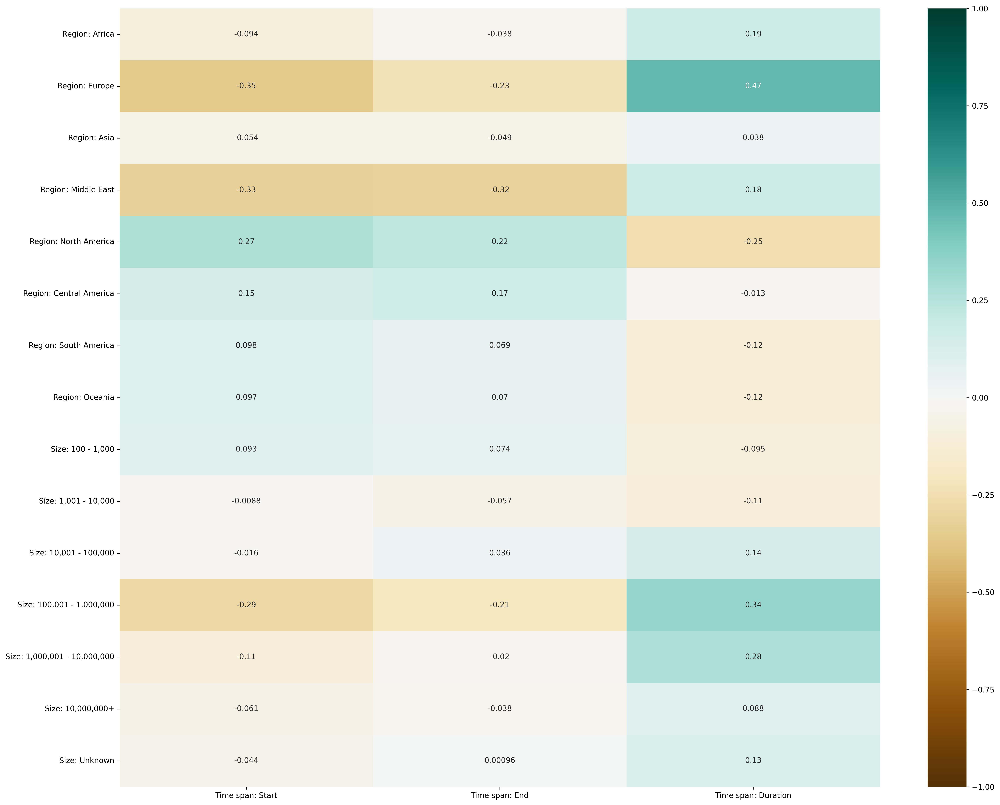

In [82]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/communities_time_correlations.png')
plt.show()

## Region

In [83]:
region_corr = norm_corr[region_cols].loc[time_span_cols + size_cols]

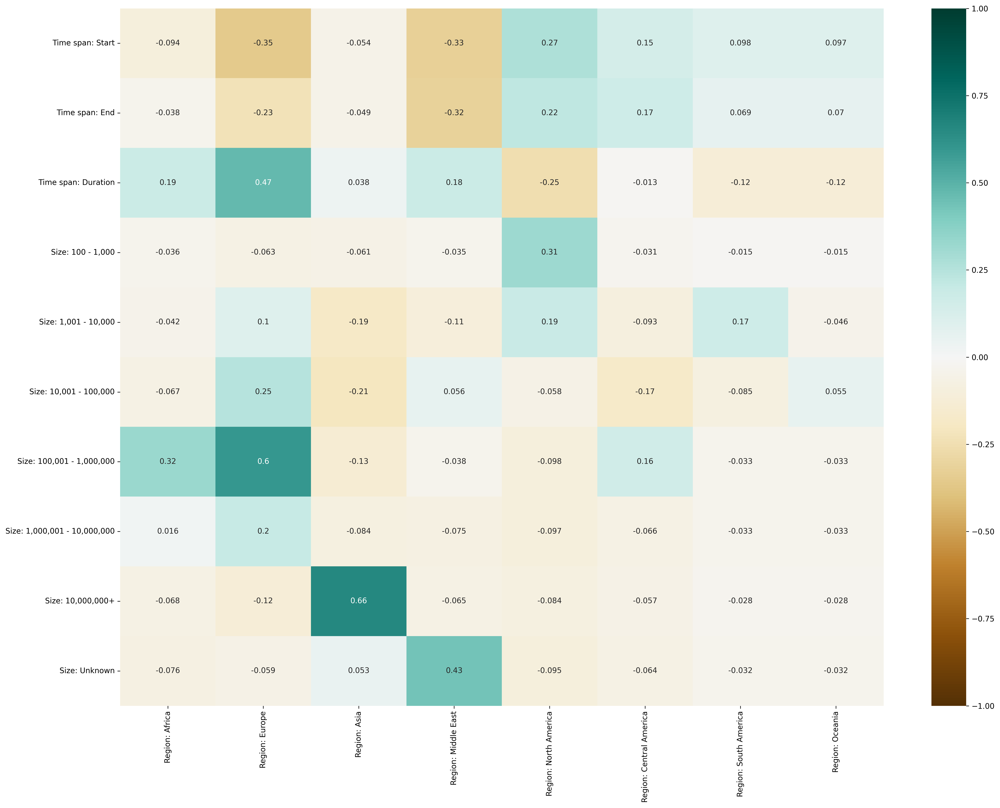

In [84]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/communities_region_correlations.png')
plt.show()

## Size 

In [85]:
size_corr = norm_corr[size_cols].loc[time_span_cols + region_cols]

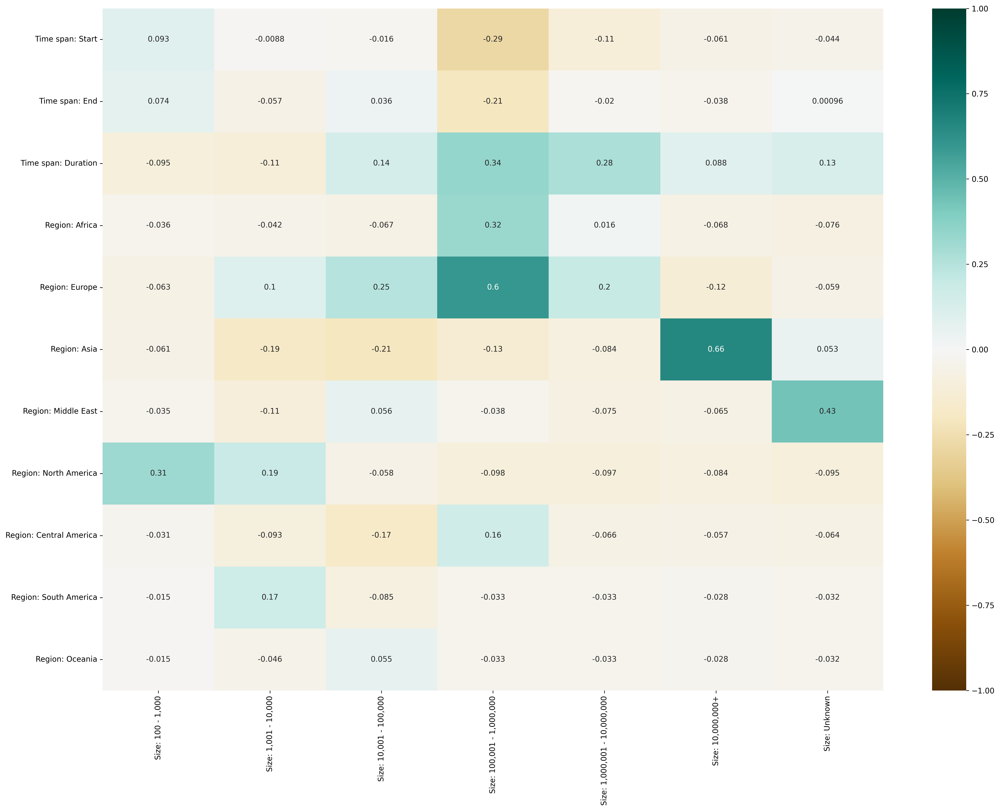

In [86]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_corr,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig('../v2-fig/fig-correlations/communities_size_correlations.png')
plt.show()